# import library

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
import datetime as dt
from statsmodels.tsa.seasonal import seasonal_decompose             # Time series components
from statsmodels.tsa.stattools import adfuller                      # To find the stationarity of the data
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf       # To plot ACF and PACF plots
from statsmodels.tsa.arima.model import ARIMA                       # To build the ARIMA model
from sklearn.metrics import mean_squared_error                      # To check the mean square error                                      
from statsmodels.tsa.statespace.sarimax import SARIMAX              # To build the sarimax model 
import statsmodels.api as sm                                 
import warnings
warnings.filterwarnings('ignore')

In [2]:
beauty=pd.read_csv('beauty_cleandata11.csv')#read data

In [3]:
beauty.head() #top five

,Unnamed: 0,asin,title,overall,brand,rank,verified,reviewerID,reviewerName,reviewTime,price,style,also_buy,also_view,main_cat,Review,polarity,Sentiment
0,0,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,ASZO5WJA6FVVH,Petra Zender,2015-03-09,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,day favorite glad itfive star,0.500000,Positive
1,1,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A1KU7EEUGYOJYD,V,2015-03-02,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,love way perfume smell soft sexy scentfive star,0.366667,Positive
2,2,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A1907XNEJPEZEI,Linda Giambrone,2015-02-19,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,love perfume compliment itfive star,0.500000,Positive
3,3,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A3U7B0EKSK16MQ,Kane,2015-01-14,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,scent slightly sweet spicy warm definitely uni...,0.244444,Positive
4,4,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,False,A3OCOP75PMY097,Jim Francis,2013-01-13,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,package complete satisfaction wife smell great...,0.227778,Positive


In [4]:
beauty.drop('Unnamed: 0',axis=1,inplace=True)# drop unnamed column

In [5]:
beauty2 = beauty[["Sentiment","Review"]]
beauty2.groupby('Sentiment').describe()

Review                                  
           count unique                   top freq
Sentiment                                         
Negative    7584   7436  poor qualityone star    4
Neutral    10025   6869         goodfive star  402
Positive   51333  47813      love itfive star  437

In [6]:
beauty.shape

(68943, 17)

In [7]:
beauty.isnull().sum() #check null value

asin            0
title           0
overall         0
brand           0
rank            0
verified        0
reviewerID      0
reviewerName    3
reviewTime      0
price           0
style           0
also_buy        0
also_view       0
main_cat        0
Review          1
polarity        0
Sentiment       0
dtype: int64

In [8]:
beauty.dropna(inplace=True)#drop null value

#### Convert the reviewTime column to a datetime format:

In [9]:
beauty['reviewTime'] = pd.to_datetime(beauty['reviewTime'])

In [10]:
beauty.dtypes#check datatypes

asin                    object
title                   object
overall                  int64
brand                   object
rank                     int64
verified                  bool
reviewerID              object
reviewerName            object
reviewTime      datetime64[ns]
price                  float64
style                   object
also_buy                object
also_view               object
main_cat                object
Review                  object
polarity               float64
Sentiment               object
dtype: object

# Sentiment Forcasting

## sentiment forecasting using time series analysis can provide valuable insights into customer sentiment trends and help businesses make informed decisions to improve customer satisfaction and loyalty.

#### Convert the reviewTime column to a datetime format:

In [11]:
df=beauty.copy()
df.head(5)

,asin,title,overall,brand,rank,verified,reviewerID,reviewerName,reviewTime,price,style,also_buy,also_view,main_cat,Review,polarity,Sentiment
0,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,ASZO5WJA6FVVH,Petra Zender,2015-03-09,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,day favorite glad itfive star,0.500000,Positive
1,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A1KU7EEUGYOJYD,V,2015-03-02,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,love way perfume smell soft sexy scentfive star,0.366667,Positive
2,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A1907XNEJPEZEI,Linda Giambrone,2015-02-19,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,love perfume compliment itfive star,0.500000,Positive
3,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A3U7B0EKSK16MQ,Kane,2015-01-14,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,scent slightly sweet spicy warm definitely uni...,0.244444,Positive
4,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,False,A3OCOP75PMY097,Jim Francis,2013-01-13,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,package complete satisfaction wife smell great...,0.227778,Positive


In [12]:
df.dtypes

asin                    object
title                   object
overall                  int64
brand                   object
rank                     int64
verified                  bool
reviewerID              object
reviewerName            object
reviewTime      datetime64[ns]
price                  float64
style                   object
also_buy                object
also_view               object
main_cat                object
Review                  object
polarity               float64
Sentiment               object
dtype: object

In [13]:
df.isnull().sum()

asin            0
title           0
overall         0
brand           0
rank            0
verified        0
reviewerID      0
reviewerName    0
reviewTime      0
price           0
style           0
also_buy        0
also_view       0
main_cat        0
Review          0
polarity        0
Sentiment       0
dtype: int64

In [14]:
# Setting the index as Date
df= df.set_index('reviewTime')
df.head()

,asin,title,overall,brand,rank,verified,reviewerID,reviewerName,price,style,also_buy,also_view,main_cat,Review,polarity,Sentiment
reviewTime,,,,,,,,,,,,,,,,
2015-03-09,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,ASZO5WJA6FVVH,Petra Zender,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,day favorite glad itfive star,0.500000,Positive
2015-03-02,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A1KU7EEUGYOJYD,V,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,love way perfume smell soft sexy scentfive star,0.366667,Positive
2015-02-19,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A1907XNEJPEZEI,Linda Giambrone,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,love perfume compliment itfive star,0.500000,Positive
2015-01-14,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A3U7B0EKSK16MQ,Kane,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,scent slightly sweet spicy warm definitely uni...,0.244444,Positive
2013-01-13,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,False,A3OCOP75PMY097,Jim Francis,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,package complete satisfaction wife smell great...,0.227778,Positive


In [18]:
positive=df[(df['Sentiment']=='Positive') & (df['brand'] == 'Astra')]
negative=df[(df['Sentiment']=='Negative')& (df['brand'] == 'Astra')]
neutral=df[(df['Sentiment']=='Neutral')& (df['brand'] == 'Astra')]

In [19]:
pos_df=positive[['polarity']]
pos_df

,polarity
reviewTime,
2010-07-14,0.283333
2010-07-06,0.060417
2009-11-17,0.421488
2018-06-05,1.000000
2018-06-05,0.237500
...,...
2018-06-08,0.700000
2018-06-08,0.037857
2018-06-06,0.042593


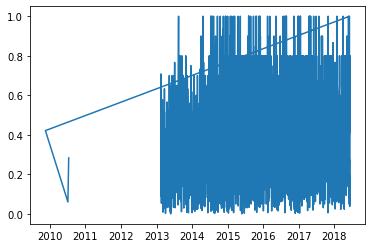

In [20]:
plt.plot(pos_df);

In [21]:
pos_df= pos_df.resample('MS').mean()
pos_df.isnull().sum()

polarity    37
dtype: int64

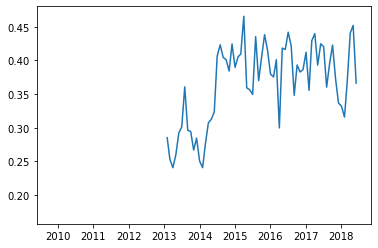

In [22]:
plt.plot(pos_df);

In [23]:
pos_df["polarity"] = pos_df["polarity"].interpolate(option="spline")

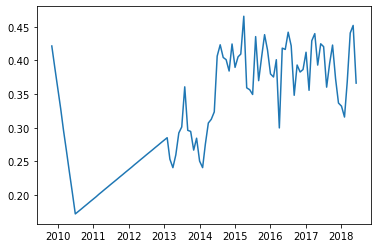

In [24]:
plt.plot(pos_df);

In [25]:
def check_data(data):
    pvalue = adfuller(data)[1]
    print("pvalue",pvalue)
    if pvalue < 0.05:
        msg = "Data is stationary"
    else:
        msg = "Data is not stationary"
    return msg

In [26]:
check_data(pos_df)

pvalue 0.47934709863953695


'Data is not stationary'

In [27]:
for i in range(1,5):
    x = pos_df-pos_df.shift(i)
    x.dropna(inplace=True)
    msg = check_data(x)
    if msg == "Data is stationary":
        print("Shift value",i,msg)
        break

pvalue 2.6839013203075874e-09
Shift value 1 Data is stationary


In [28]:
# Decomposition plot for predicted data using Features
decomposition_p=seasonal_decompose((pos_df), period=12)
trend=decomposition_p.trend
seasonal=decomposition_p.seasonal
residual=decomposition_p.resid

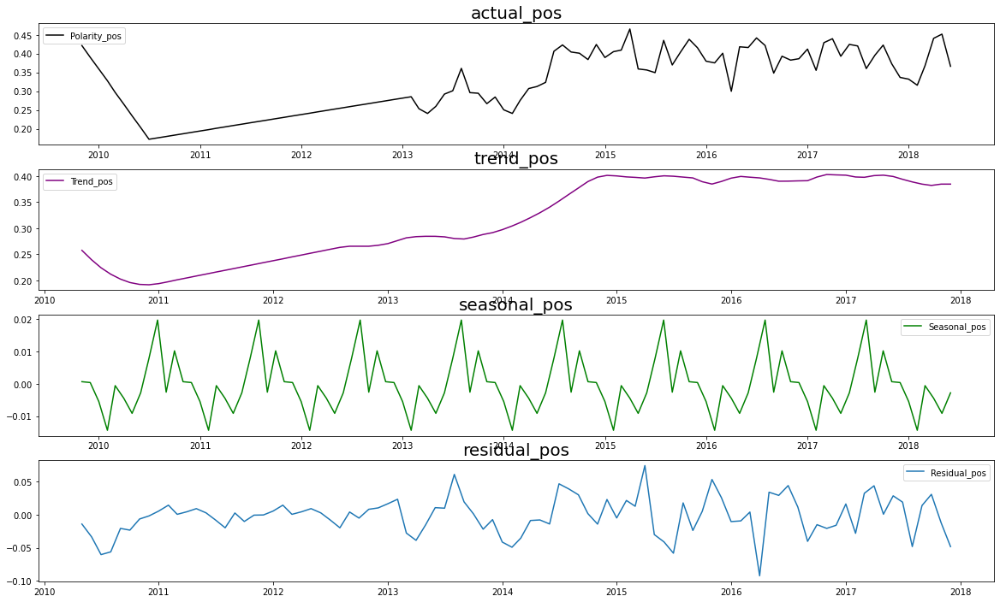

In [29]:
ig,ax = plt.subplots(4,1,figsize=(20,12))

plt.subplot(411)
plt.plot(pos_df,label='Polarity_pos',c='black')
plt.legend()
plt.title('actual_pos', fontsize = 20)

plt.subplot(412)
plt.plot(trend,label='Trend_pos',c='purple')
plt.legend()
plt.title('trend_pos', fontsize = 20)

plt.subplot(413)
plt.plot(seasonal,label='Seasonal_pos',c='green')
plt.legend()
plt.title('seasonal_pos', fontsize = 20)

plt.subplot(414)
plt.plot(residual,label='Residual_pos')
plt.legend()
plt.title('residual_pos', fontsize = 20)
plt.show()

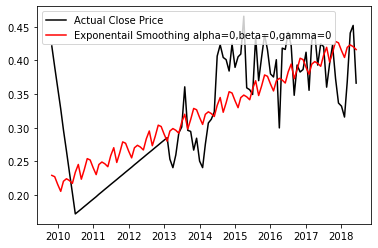

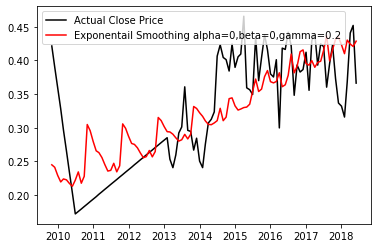

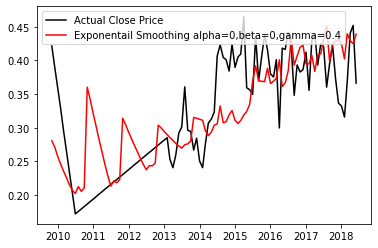

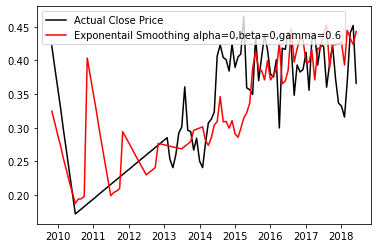

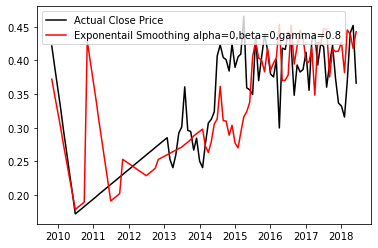

...

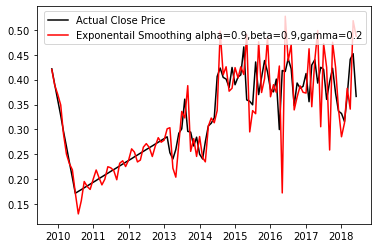

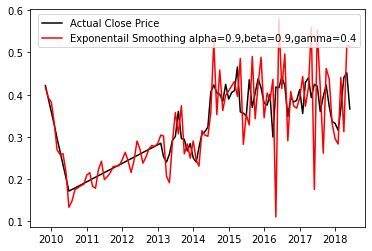

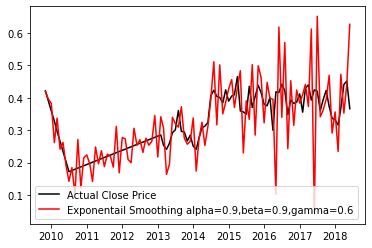

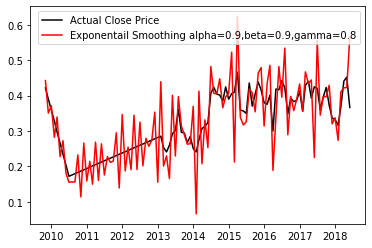

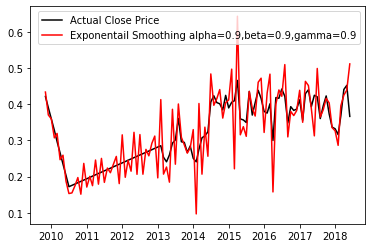

In [30]:
from statsmodels.tsa.api import ExponentialSmoothing
for alpha in [0,0.2,0.4,0.6,0.8,0.9]:
    for beta in [0,0.2,0.4,0.6,0.8,0.9]:
        for gamma in [0,0.2,0.4,0.6,0.8,0.9]:
            model = ExponentialSmoothing(pos_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
            plt.plot(pos_df,color='black',label="Actual Close Price")
            plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing alpha={alpha},beta={beta},gamma={gamma}')
            plt.legend()
            plt.show();

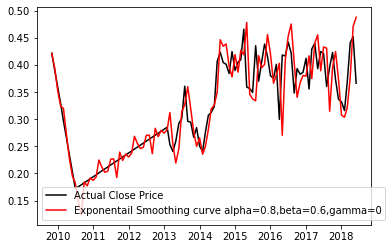

In [31]:
alpha = 0.8
beta = 0.6
gamma = 0
model = ExponentialSmoothing(pos_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
plt.plot(pos_df,color='black',label="Actual Close Price")
plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing curve alpha={alpha},beta={beta},gamma={gamma}')
plt.legend()
plt.show();

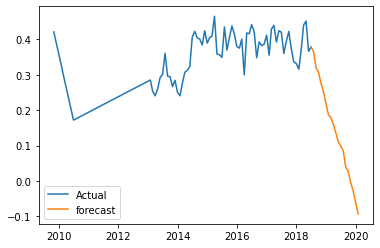

In [32]:
cd = model.forecast(20)
bx = pos_df["polarity"].append(cd[0:1])
plt.plot(bx,label="Actual")
plt.plot(cd,label="forecast")
plt.legend();

In [33]:
check_data(model.fittedvalues)

pvalue 0.14755730700565195


'Data is not stationary'

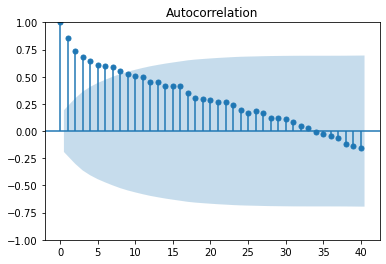

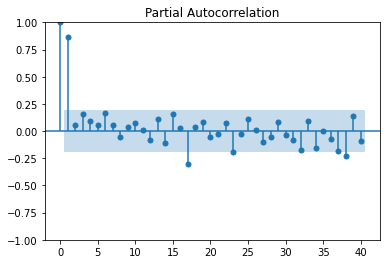

In [34]:
plot_acf(model.fittedvalues,lags=40)
plot_pacf(model.fittedvalues,lags=40);

In [35]:
for p in range(1,3):
    for q in range(1,8):
        mod = sm.tsa.statespace.SARIMAX(model.fittedvalues,order=(p,1,q),seasonal_order=None).fit()
        print("for ", p , q, mod.aic)

for  1 1 -348.67677663184855
for  1 2 -346.74712956858485
for  1 3 -344.8063726725934
for  1 4 -342.80929235212733
for  1 5 -341.6259982415546
for  1 6 -339.7297932990516
for  1 7 -338.1137284314954
for  2 1 -346.7401467480073
for  2 2 -344.74810384911854
for  2 3 -342.7917417646801
for  2 4 -340.8136470661399
for  2 5 -339.9246317623836
for  2 6 -338.03767910155074
for  2 7 -336.8574277965326


In [36]:
rows = int(0.8*len(model.fittedvalues))
pos_train = pos_df[:rows]

pos_test = pos_df[rows:]

In [37]:
pos_mod = sm.tsa.statespace.SARIMAX(pos_train,order=(2,1,7),seasonal_order=(2,1,7,10)).fit()
pp_model = pos_mod.fittedvalues
print(pos_mod.summary())

                                     SARIMAX Results                                      
Dep. Variable:                           polarity   No. Observations:                   83
Model:             SARIMAX(2, 1, 7)x(2, 1, 7, 10)   Log Likelihood                 135.932
Date:                            Tue, 11 Apr 2023   AIC                           -233.863
Time:                                    21:31:21   BIC                           -190.606
Sample:                                11-01-2009   HQIC                          -216.642
                                     - 09-01-2016                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9297     11.249     -0.083      0.934     -22.977      21.118
ar.L2         -0.1825      5.644   

In [38]:
pos_str = len(pos_train)
pos_end = len(pos_train)+(len(pos_test)-1)

In [39]:
pvalue = sm.stats.acorr_ljungbox(pos_mod.resid,lags=[1],return_df=True)['lb_pvalue'].values
print(pvalue)
if pvalue < 0.05:
    print('Reject H0.BAD MODEL')
else:
    print("FAILED to Reject H0.Good MODEL")

[0.76435697]
FAILED to Reject H0.Good MODEL


In [40]:
forcast = pos_mod.forecast(60)

In [41]:
pos_pred = pos_mod.predict(pos_str,pos_end)

In [42]:
df_sarima_res_pos = pd.DataFrame({"Predictions":pos_pred})
df_sarima_res_pos["Actual"] = pos_test
df_sarima_res_pos["err"] = df_sarima_res_pos["Actual"]-df_sarima_res_pos["Predictions"]

df_sarima_res_pos

,Predictions,Actual,err
2016-10-01,0.399471,0.393195,-0.006276
2016-11-01,0.287135,0.382790,0.095654
2016-12-01,0.359364,0.386514,0.027150
2017-01-01,0.321318,0.412199,0.090882
2017-02-01,0.305231,0.355599,0.050368
2017-03-01,0.356693,0.429221,0.072528
2017-04-01,0.381311,0.439857,0.058547
2017-05-01,0.365126,0.393088,0.027962
2017-06-01,0.382570,0.424723,0.042153
2017-07-01,0.359205,0.420503,0.061298


In [43]:
pos_pp = pos_train["polarity"].append(pos_pred[0:1])

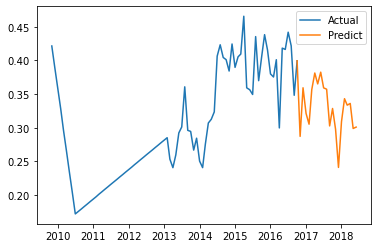

In [44]:
plt.plot(pos_pp,label="Actual")
plt.plot(pos_pred,label="Predict")
plt.legend();

In [45]:
from sklearn.metrics import mean_squared_error
pos_mse = mean_squared_error(pos_pred,pos_test)
print("Positive mse",pos_mse)
print("Positive rmse",np.sqrt(pos_mse))

Positive mse 0.005201653981388966
Positive rmse 0.0721224928949975


# Negative Sentiment Time Series Analysis

In [46]:
neg_df=negative[['polarity']]
neg_df

,polarity
reviewTime,
2018-05-30,-0.021429
2018-05-28,-0.425000
2018-05-27,-0.011237
2018-05-25,-0.245833
2018-05-17,-0.468750
...,...
2013-02-27,-0.015236
2013-02-19,-0.062500
2013-02-17,-0.078571


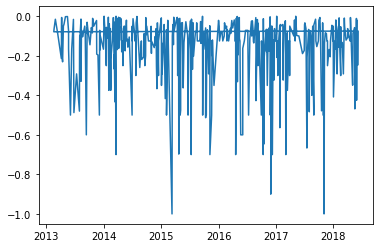

In [47]:
plt.plot(neg_df);

In [48]:
neg_df= neg_df.resample('MS').mean()
neg_df.isnull().sum()

polarity    0
dtype: int64

In [49]:
neg_df["polarity"] = neg_df["polarity"].interpolate(option='spline')
neg_df.isnull().sum()

polarity    0
dtype: int64

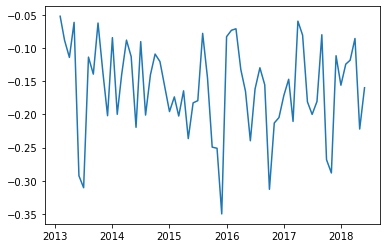

In [50]:
plt.plot(neg_df);

In [51]:
check_data(neg_df)

pvalue 1.9356329184764624e-09


'Data is stationary'

In [52]:
for i in range(1,5):
    x = neg_df-neg_df.shift(i)
    x.dropna(inplace=True)
    msg = check_data(x)
    if msg == "Data is stationary":
        print("Shift value",i,msg)
        break

pvalue 5.71974654654299e-07
Shift value 1 Data is stationary


In [53]:
# Decomposition plot for predicted data using Features
decomposition_p=seasonal_decompose((neg_df), period=12)
trend=decomposition_p.trend
seasonal=decomposition_p.seasonal
residual=decomposition_p.resid

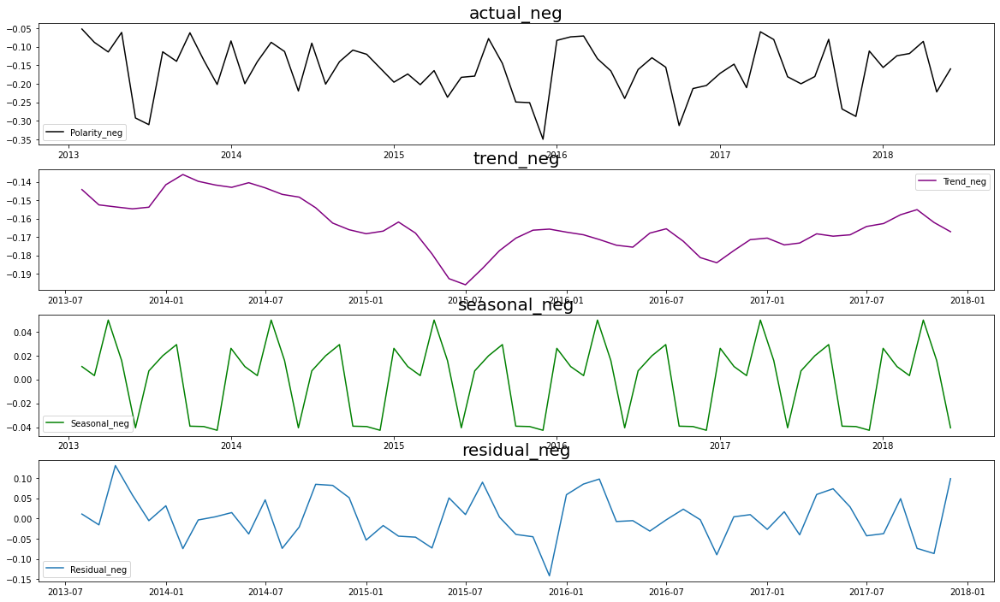

In [54]:
ig,ax = plt.subplots(4,1,figsize=(20,12))

plt.subplot(411)
plt.plot(neg_df,label='Polarity_neg',c='black')
plt.legend()
plt.title('actual_neg', fontsize = 20)

plt.subplot(412)
plt.plot(trend,label='Trend_neg',c='purple')
plt.legend()
plt.title('trend_neg', fontsize = 20)

plt.subplot(413)
plt.plot(seasonal,label='Seasonal_neg',c='green')
plt.legend()
plt.title('seasonal_neg', fontsize = 20)

plt.subplot(414)
plt.plot(residual,label='Residual_neg')
plt.legend()
plt.title('residual_neg', fontsize = 20)
plt.show()

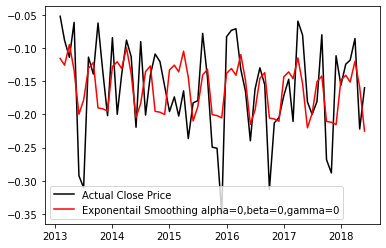

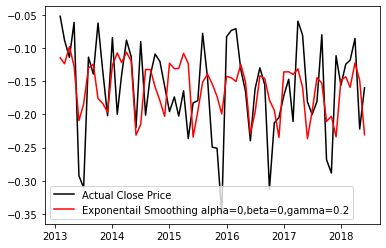

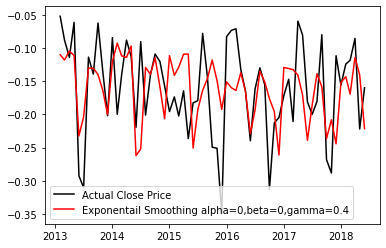

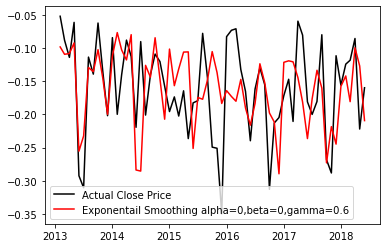

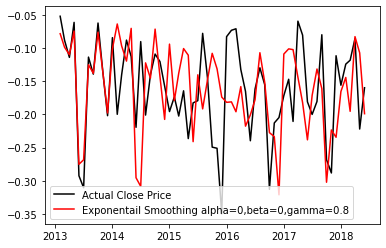

...

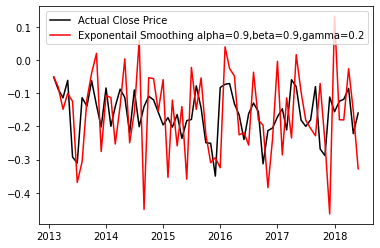

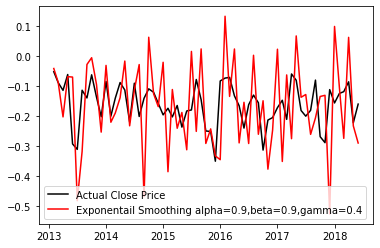

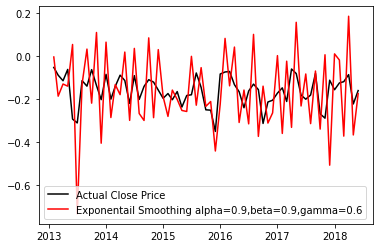

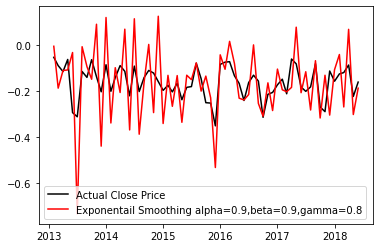

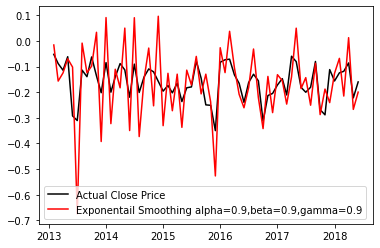

In [55]:
for alpha in [0,0.2,0.4,0.6,0.8,0.9]:
    for beta in [0,0.2,0.4,0.6,0.8,0.9]:
        for gamma in [0,0.2,0.4,0.6,0.8,0.9]:
            model = ExponentialSmoothing(neg_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
            plt.plot(neg_df,color='black',label="Actual Close Price")
            plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing alpha={alpha},beta={beta},gamma={gamma}')
            plt.legend()
            plt.show();

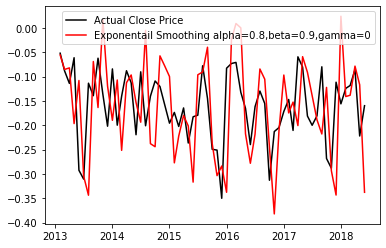

In [56]:
alpha = 0.8
bete = 0.2
gamma = 0
model = ExponentialSmoothing(neg_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
plt.plot(neg_df,color='black',label="Actual Close Price")
plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing alpha={alpha},beta={beta},gamma={gamma}')
plt.legend()
plt.show();

In [57]:
sx = model.forecast(60)
dd = neg_df["polarity"].append(sx[0:1])

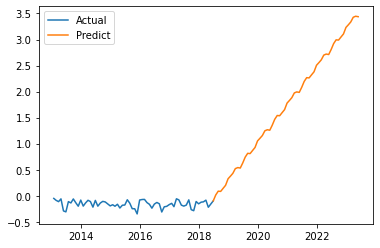

In [58]:
plt.plot(dd,label="Actual")
plt.plot(sx,label="Predict")
plt.legend();

In [59]:
check_data(model.fittedvalues)

pvalue 1.0206545871155773e-08


'Data is stationary'

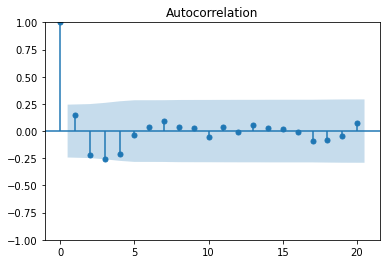

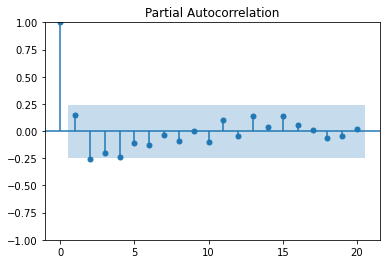

In [61]:
plot_acf(model.fittedvalues,lags=20)
plot_pacf(model.fittedvalues,lags=20);

In [62]:
for q in range(1,2):
    for p in range(1,3):
        mod = sm.tsa.statespace.SARIMAX(model.fittedvalues,order=(p,1,q),seasonal_order=None).fit()
        print("for ", p , q, mod.aic)

for  1 1 -103.35715733799896
for  2 1 -105.14004889769814


In [63]:
n_num = int(0.8*len(model.fittedvalues))
neg_train = neg_df[:n_num]
neg_test = neg_df[n_num:]


In [64]:
negs_mod = sm.tsa.statespace.SARIMAX(neg_train,order=(1,1,1),seasonal_order=(1,1,1,10)).fit()
nn_model = negs_mod.fittedvalues
print(negs_mod.summary())

                                     SARIMAX Results                                      
Dep. Variable:                           polarity   No. Observations:                   52
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 10)   Log Likelihood                  42.620
Date:                            Tue, 11 Apr 2023   AIC                            -75.241
Time:                                    21:38:12   BIC                            -66.673
Sample:                                02-01-2013   HQIC                           -72.121
                                     - 05-01-2017                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1678      0.204      0.823      0.410      -0.232       0.568
ma.L1         -0.9938      4.125   

In [65]:
pvalue = sm.stats.acorr_ljungbox(negs_mod.resid,lags=[1],return_df=True)['lb_pvalue'].values
print(pvalue)
if pvalue < 0.05:
    print('Reject H0.BAD MODEL')
else:
    print("FAILED to Reject H0.Good MODEL")

[0.76746085]
FAILED to Reject H0.Good MODEL


In [66]:
nn_str = len(neg_train)
nn_end = len(neg_train)+len(neg_test)-1

In [67]:
ng_pred = negs_mod.forecast(60)

In [68]:
nn_pred = negs_mod.predict(nn_str,nn_end)
nnd = neg_train["polarity"].append(nn_pred[0:1])

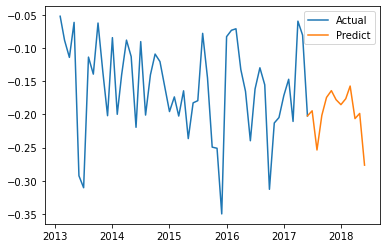

In [69]:
plt.plot(nnd,label="Actual")
plt.plot(nn_pred,label="Predict")
plt.legend();

In [70]:
ndf_sarima_res = pd.DataFrame({"Predictions":nn_pred})
ndf_sarima_res["Actual"] = neg_test
ndf_sarima_res["err"] = ndf_sarima_res["Actual"]-ndf_sarima_res["Predictions"]

ndf_sarima_res

,Predictions,Actual,err
2017-06-01,-0.202276,-0.181111,0.021165
2017-07-01,-0.194623,-0.200060,-0.005437
2017-08-01,-0.253645,-0.180543,0.073102
2017-09-01,-0.201491,-0.079981,0.121510
2017-10-01,-0.174455,-0.268287,-0.093832
2017-11-01,-0.164233,-0.288281,-0.124048
2017-12-01,-0.177837,-0.111627,0.066210
2018-01-01,-0.185341,-0.156052,0.029290
2018-02-01,-0.176385,-0.124309,0.052077
2018-03-01,-0.157302,-0.118382,0.038920


In [71]:
neg_mse = mean_squared_error(nn_pred,neg_test)
print("Negative mse",neg_mse)
print("Negative rmse",np.sqrt(neg_mse))

Negative mse 0.006383734855241132
Negative rmse 0.07989827817444586


In [72]:
import plotly.express as px
import plotly.graph_objects as go
import plotly.graph_objects as go
from plotly.offline import plot

In [73]:
x = pos_pp.index
y = pos_pp.values
trace1 = go.Scatter(x=x,y=y,name="Pervious Trend of Positive Reviews")
x1 = forcast.index
y1 = forcast.values
trace2 = go.Scatter(x=x1,y=y1,name="Forecasted Trend of Positive Reviews")

data = [trace1,trace2]
layout = go.Layout(title = "All Beauty Review Data",yaxis=dict(title="Polarity score",zeroline=True,showline=True),
                  xaxis = dict(title = "Year"))

fig = go.Figure(data=data,layout=layout)

fig.show()


## line chart to visualize the trend of forcasting positive reviews for the "All Beauty" dataset.

In [74]:
x = nnd.index
y = nnd.values
trace1 = go.Scatter(x=x,y=y,name="Pervious trend of Negative Reviews")
x1 = ng_pred.index
y1 = ng_pred.values
trace2 = go.Scatter(x=x1,y=y1,name="Forecasted Future trend of Negative Reviews")

data = [trace1,trace2]
layout = go.Layout(title = "All Beauty",yaxis=dict(title="Polarity Score",zeroline=True,showline=True),
                  xaxis = dict(title = "Year"))

fig = go.Figure(data=data,layout=layout)

fig.show()

## line chart to visualize the trend of forcasting negative reviews for the "All Beauty" dataset

In [71]:
plt.savefig('my_graphpos.png')

<Figure size 432x288 with 0 Axes>

In [72]:
plt.savefig('my_graphpos1.pdf', format='pdf')


<Figure size 432x288 with 0 Axes>